In [1]:
import pandas as pd

df = pd.read_csv("../data/All_Pokemon_cleaned.csv")
df

,number,name,type_1,type_2,abilities,hp,att,def,spa,spd,...,against_rock,against_ghost,against_dragon,against_dark,against_steel,against_fairy,height,weight,bmi,bmi_clipped
0,1,bulbasaur,grass,poison,"['chlorophyll', 'overgrow']",45,49,49,65,65,...,1.0,1.0,1.0,1.0,1.0,0.5,0.7,6.9,14.1,14.1
1,2,ivysaur,grass,poison,"['chlorophyll', 'overgrow']",60,62,63,80,80,...,1.0,1.0,1.0,1.0,1.0,0.5,1.0,13.0,13.0,13.0
2,3,venusaur,grass,poison,"['chlorophyll', 'overgrow']",80,82,83,100,100,...,1.0,1.0,1.0,1.0,1.0,0.5,2.0,100.0,25.0,25.0
3,3,mega_venusaur,grass,poison,['thick fat'],80,100,123,122,120,...,1.0,1.0,1.0,1.0,1.0,0.5,2.4,155.5,27.0,27.0
4,4,charmander,fire,none,"['blaze', 'solar power']",39,52,43,60,50,...,2.0,1.0,1.0,1.0,0.5,0.5,0.6,8.5,23.6,23.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,896,glastrier,ice,none,['chilling neigh'],100,145,130,65,110,...,2.0,1.0,1.0,1.0,2.0,1.0,2.2,800.0,165.3,100.0
1028,897,spectrier,ghost,none,['grim neigh'],100,65,60,145,80,...,1.0,2.0,1.0,2.0,1.0,1.0,2.0,44.5,11.1,11.1
1029,898,calyrex,psychic,grass,['unnerve'],100,80,80,80,80,...,1.0,2.0,1.0,2.0,1.0,1.0,1.1,7.7,6.4,6.4
1030,898,calyrex_ice_rider,psychic,ice,['as one'],100,165,150,85,130,...,2.0,2.0,1.0,2.0,2.0,1.0,2.4,809.1,140.5,100.0


In [2]:
unnecesary_columns = [
    "number",
    "name",
    "mean",
    "standard_deviation",
    "abilities",
    "bmi",
]
df.drop(unnecesary_columns, axis=1, inplace=True)

In [3]:
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import shap
from lightgbm import LGBMClassifier

C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
le1 = LabelEncoder()
df["type_1"] = le1.fit_transform(df["type_1"])

le2 = LabelEncoder()
df["type_2"] = le2.fit_transform(df["type_2"])

df.head()

,type_1,type_2,hp,att,def,spa,spd,spe,bst,generation,...,against_bug,against_rock,against_ghost,against_dragon,against_dark,against_steel,against_fairy,height,weight,bmi_clipped
0,9,14,45,49,49,65,65,45,318,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,0.5,0.7,6.9,14.1
1,9,14,60,62,63,80,80,60,405,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,0.5,1.0,13.0,13.0
2,9,14,80,82,83,100,100,80,525,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,0.5,2.0,100.0,25.0
3,9,14,80,100,123,122,120,80,625,6.0,...,1.0,1.0,1.0,1.0,1.0,1.0,0.5,2.4,155.5,27.0
4,6,12,39,52,43,60,50,65,309,1.0,...,0.5,2.0,1.0,1.0,1.0,0.5,0.5,0.6,8.5,23.6


In [5]:
# One-hot encode the 'experience_type' column
ohe = OneHotEncoder(sparse_output=False, handle_unknown="ignore")
df_exp = pd.DataFrame(ohe.fit_transform(df[["experience_type"]]))
df_exp.columns = ohe.get_feature_names_out(["experience_type"])

df = pd.concat([df.drop("experience_type", axis=1), df_exp], axis=1)
df

,type_1,type_2,hp,att,def,spa,spd,spe,bst,generation,...,against_fairy,height,weight,bmi_clipped,experience_type_Erratic,experience_type_Fast,experience_type_Fluctuating,experience_type_Medium Fast,experience_type_Medium Slow,experience_type_Slow
0,9,14,45,49,49,65,65,45,318,1.0,...,0.5,0.7,6.9,14.1,0.0,0.0,0.0,0.0,1.0,0.0
1,9,14,60,62,63,80,80,60,405,1.0,...,0.5,1.0,13.0,13.0,0.0,0.0,0.0,0.0,1.0,0.0
2,9,14,80,82,83,100,100,80,525,1.0,...,0.5,2.0,100.0,25.0,0.0,0.0,0.0,0.0,1.0,0.0
3,9,14,80,100,123,122,120,80,625,6.0,...,0.5,2.4,155.5,27.0,0.0,0.0,0.0,0.0,1.0,0.0
4,6,12,39,52,43,60,50,65,309,1.0,...,0.5,0.6,8.5,23.6,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1027,11,12,100,145,130,65,110,30,580,8.0,...,1.0,2.2,800.0,100.0,0.0,0.0,0.0,0.0,0.0,1.0
1028,8,12,100,65,60,145,80,130,580,8.0,...,1.0,2.0,44.5,11.1,0.0,0.0,0.0,0.0,0.0,1.0
1029,14,9,100,80,80,80,80,80,500,8.0,...,1.0,1.1,7.7,6.4,0.0,0.0,0.0,0.0,0.0,1.0
1030,14,11,100,165,150,85,130,50,680,8.0,...,1.0,2.4,809.1,100.0,0.0,0.0,0.0,0.0,0.0,1.0


In [6]:
X = df.drop(["type_1", "type_2"], axis=1)
y = df["type_1"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

print(f"X_train.shape: {X_train.shape}")
print(f"X_test.shape: {X_test.shape}")

X_train.shape: (825, 42)
X_test.shape: (207, 42)


C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] The system cannot find the file specified
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
        "wmic CPU Get NumberOfCores /Format:csv".split(),
        capture_output=True,
        text=True,
    )
  File "c:\Python313\Lib\subprocess.py", line 556, in run
    with Popen(*popenargs, **kwargs) as process:
         ~~~~~^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Python313\Lib\subprocess.py", line 1038, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
   

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.246482 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1135
[LightGBM] [Info] Number of data points in the train set: 660, number of used features: 39
[LightGBM] [Info] Start training from score -2.600420
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from score -2.854654
[LightGBM] [Info] Start training from score -3.853183
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.854654
[LightGBM] [Info] Start training from score -4.882802
[LightGBM] [Info] Start training from score -3.196403
[LightGBM] [Info] Start training from score -2.414702
[LightGBM] [Info] Start train

C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Abhishek Shrestha\AppData\Roaming\Python\Python313\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average,

Train Accuracy (LGBM): 0.9333333333333333


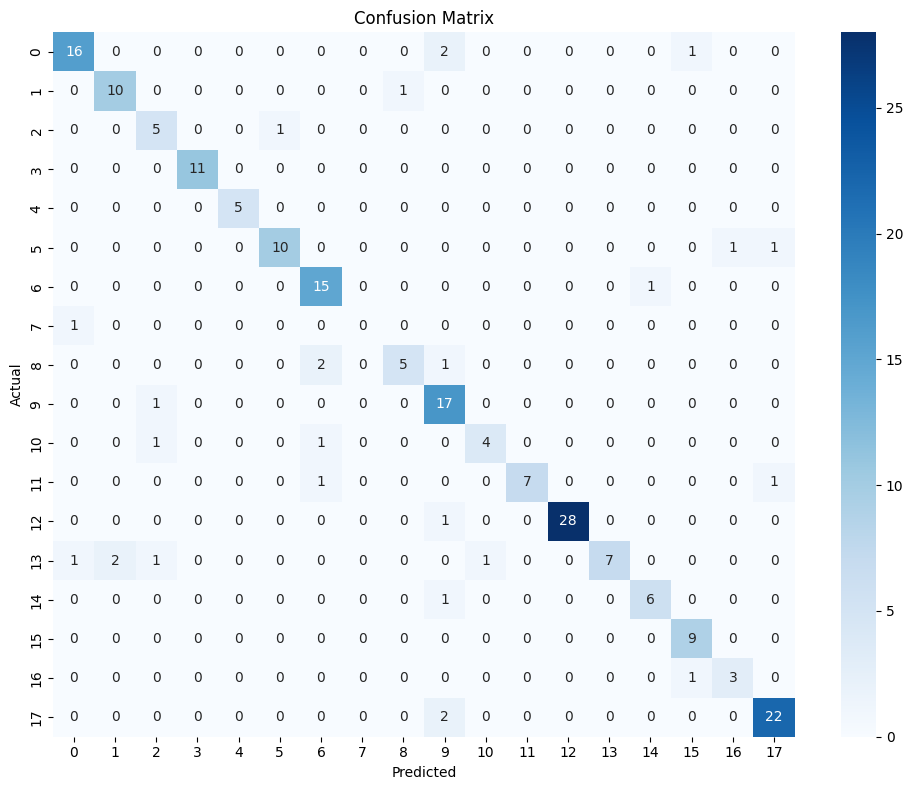

In [7]:
lgbm_model = LGBMClassifier(
    max_depth=4,
    n_estimators=100,
    learning_rate=0.05,
    subsample=0.8,
    colsample_bytree=0.8,
    min_child_weight=5,
    reg_alpha=1,
    reg_lambda=1,
    random_state=42,
)

scores = cross_val_score(lgbm_model, X_train, y_train, cv=5)
print("Cross-validation scores:", scores)
print("Mean cross-validation score:", scores.mean())

lgbm_model.fit(X_train, y_train)

y_pred = lgbm_model.predict(X_test)
print("Test Accuracy (LGBM):", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

x_train_pred = lgbm_model.predict(X_train)
print("Train Accuracy (LGBM):", accuracy_score(y_train, x_train_pred))

cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()

=== DEBUGGING SHAP VALUES STRUCTURE ===
X_test.shape: (207, 42)
Type of shap_values: <class 'numpy.ndarray'>
SHAP values structure: 207 samples, 42 features, 18 classes


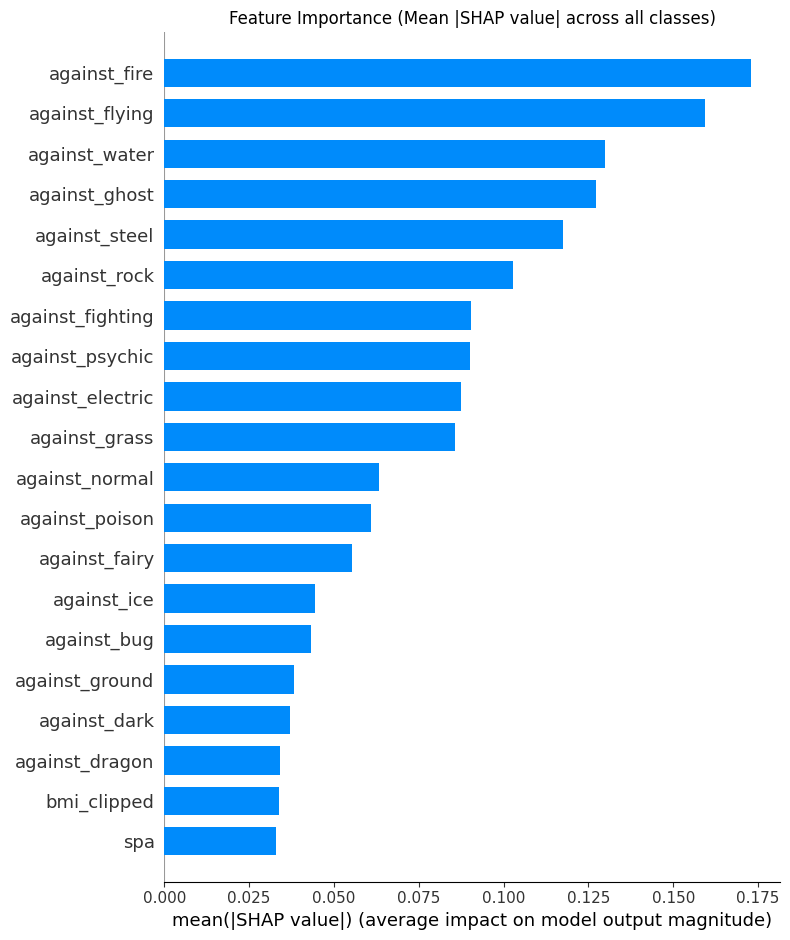

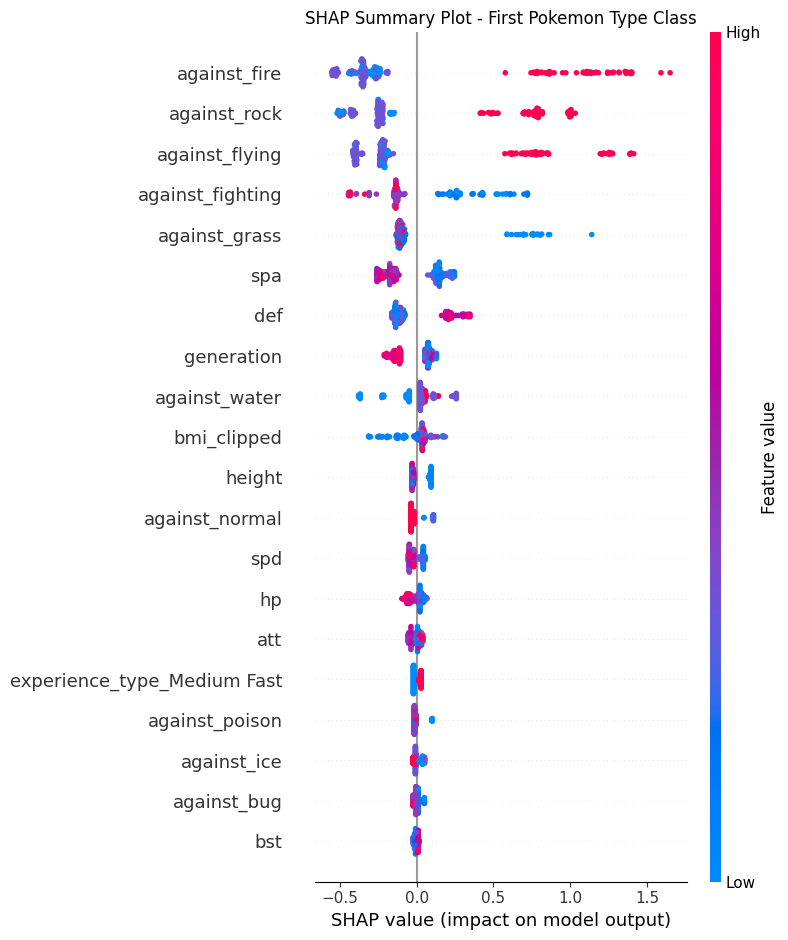

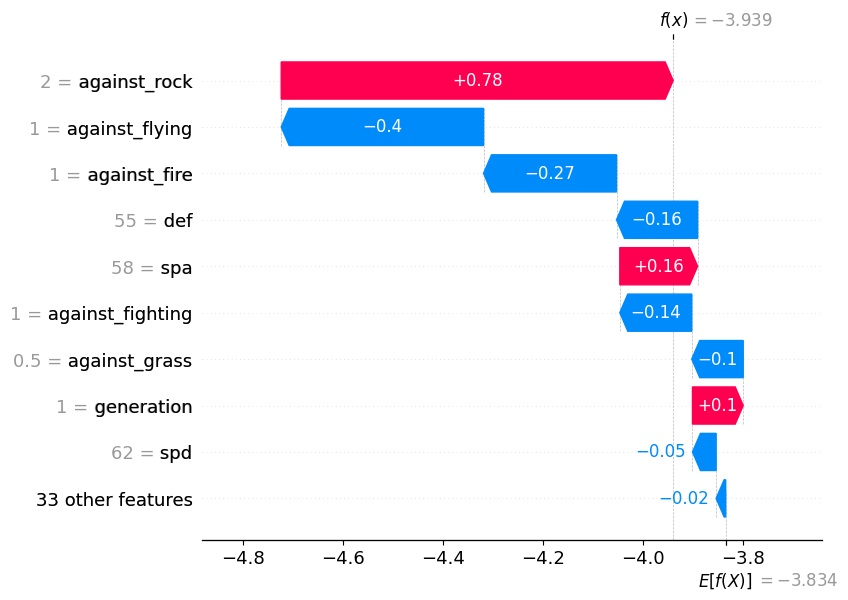


Top 10 Most Important Features (averaged across all classes and samples):
                        feature  importance
16                 against_fire    0.172845
24               against_flying    0.159276
17                against_water    0.129788
28                against_ghost    0.127187
31                against_steel    0.117581
27                 against_rock    0.102854
21             against_fighting    0.090498
25              against_psychic    0.090135
18             against_electric    0.087479
19                against_grass    0.085672
15               against_normal    0.063388
22               against_poison    0.060967
32                against_fairy    0.055429
20                  against_ice    0.044425
26                  against_bug    0.043196
23               against_ground    0.038341
30                 against_dark    0.036934
29               against_dragon    0.034159
35                  bmi_clipped    0.033775
3                           spa    0.032912
3

C:\Users\Abhishek Shrestha\AppData\Local\Temp\ipykernel_19776\1987289601.py:43: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=feature_importance, x="importance", y="feature", palette="viridis")


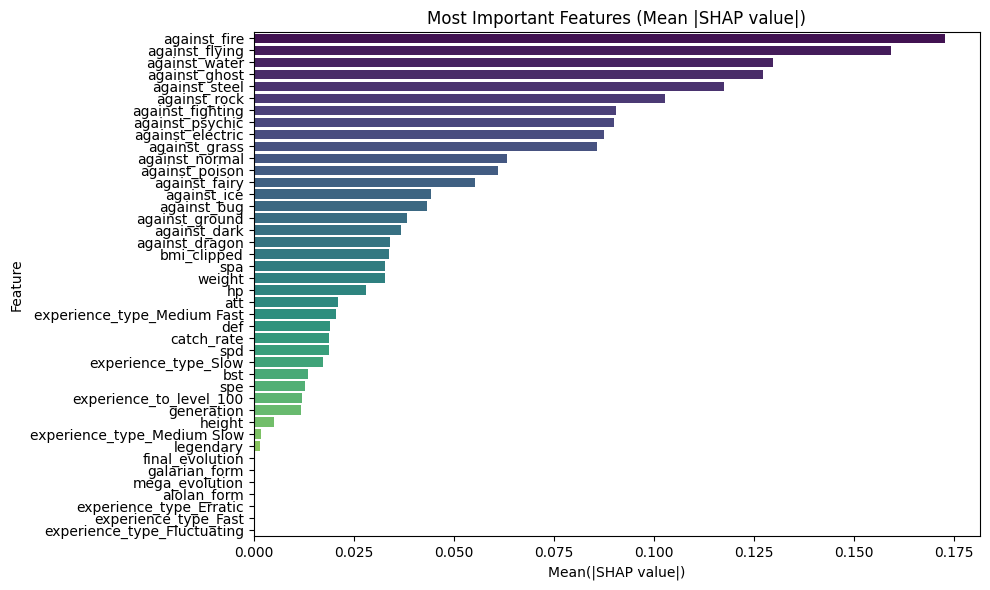


Top 10 Most Important Features for Class 0:
                        feature  importance
16                 against_fire    0.549956
27                 against_rock    0.456577
24               against_flying    0.446874
21             against_fighting    0.241971
19                against_grass    0.182578
3                           spa    0.166911
2                           def    0.155048
7                    generation    0.104531
17                against_water    0.091323
35                  bmi_clipped    0.066516
33                       height    0.042455
15               against_normal    0.041030
4                           spd    0.038854
0                            hp    0.036479
1                           att    0.022576
39  experience_type_Medium Fast    0.020089
22               against_poison    0.017960
20                  against_ice    0.016993
26                  against_bug    0.012199
6                           bst    0.007835
5                           spe

In [8]:
# SHAP analysis for LGBM
explainer = shap.TreeExplainer(lgbm_model)
shap_values = explainer.shap_values(X_test)

print("=== DEBUGGING SHAP VALUES STRUCTURE ===")
print(f"X_test.shape: {X_test.shape}")
print(f"Type of shap_values: {type(shap_values)}")
if isinstance(shap_values, list):
    shap_values = np.stack(shap_values, axis=2)
print(
    f"SHAP values structure: {shap_values.shape[0]} samples, {shap_values.shape[1]} features, {shap_values.shape[2]} classes"
)

shap_values_avg = np.mean(np.abs(shap_values), axis=2)
shap.summary_plot(shap_values_avg, X_test, plot_type="bar", show=False)
plt.title("Feature Importance (Mean |SHAP value| across all classes)")
plt.tight_layout()
plt.show()

shap_values_class0 = shap_values[:, :, 0]
shap.summary_plot(shap_values_class0, X_test, show=False)
plt.title("SHAP Summary Plot - First Pokemon Type Class")
plt.tight_layout()
plt.show()

explanation = shap.Explanation(
    values=shap_values[0, :, 0],
    base_values=explainer.expected_value[0],
    data=X_test.iloc[0].values,
    feature_names=X_test.columns.tolist(),
)
shap.waterfall_plot(explanation)

feature_importance = pd.DataFrame(
    {
        "feature": X_test.columns,
        "importance": np.mean(np.abs(shap_values), axis=(0, 2)),
    }
).sort_values("importance", ascending=False)
print("\nTop 10 Most Important Features (averaged across all classes and samples):")
print(feature_importance)
plt.figure(figsize=(10, 6))
sns.barplot(data=feature_importance, x="importance", y="feature", palette="viridis")
plt.title("Most Important Features (Mean |SHAP value|)")
plt.xlabel("Mean(|SHAP value|)")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

feature_importance_class0 = pd.DataFrame(
    {
        "feature": X_test.columns,
        "importance": np.mean(np.abs(shap_values[:, :, 0]), axis=0),
    }
).sort_values("importance", ascending=False)
print(f"\nTop 10 Most Important Features for Class 0:")
print(feature_importance_class0)
print(f"\nModel has {shap_values.shape[2]} classes (Pokemon types)")
print("SHAP values calculated for all samples, features, and classes")

In [9]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    "n_estimators": [50, 100, 200],
    "max_depth": [3, 4, 6],
    "learning_rate": [0.01, 0.05, 0.1],
    "subsample": [0.8, 1.0],
    "colsample_bytree": [0.8, 1.0],
    "min_child_weight": [1, 3, 5],
    "reg_alpha": [0, 0.5, 1],
    "reg_lambda": [1, 2],
}

lgbm_clf = LGBMClassifier(random_state=42)

grid_search = GridSearchCV(lgbm_clf, param_grid, cv=3, n_jobs=-1, scoring="accuracy")
grid_search.fit(X_train, y_train)

print("Best parameters found by GridSearchCV:", grid_search.best_params_)
print("Best cross-validation score:", grid_search.best_score_)

best_model_obtained_by_grid_cv = grid_search.best_estimator_

cv_scores = cross_val_score(best_model_obtained_by_grid_cv, X_train, y_train, cv=5)
print("Cross-validation scores (GridSearchCV best model):", cv_scores)
print("Mean cross-validation score:", cv_scores.mean())

best_model_obtained_by_grid_cv.fit(X_train, y_train)
y_train_pred = best_model_obtained_by_grid_cv.predict(X_train)
train_accuracy = accuracy_score(y_train, y_train_pred)
print("Train Accuracy (GridSearchCV best model):", train_accuracy)
print(classification_report(y_train, y_train_pred))

y_pred = best_model_obtained_by_grid_cv.predict(X_test)
print("Test Accuracy (GridSearchCV best model):", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000468 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1254
[LightGBM] [Info] Number of data points in the train set: 825, number of used features: 39
[LightGBM] [Info] Start training from score -2.588249
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.882170
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.769473
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.424924
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from s

In [ ]:
import optuna



def objective(trial):

    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),
        "max_depth": trial.suggest_categorical("max_depth", [3, 4, 6]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.1),
        "subsample": trial.suggest_float("subsample", 0.8, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.8, 1.0),
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 5),
        "reg_alpha": trial.suggest_float("reg_alpha", 0, 1),
        "reg_lambda": trial.suggest_float("reg_lambda", 1, 2),
        "random_state": 42,
    }


    clf = LGBMClassifier(**params)

    score = cross_val_score(clf, X_train, y_train, cv=3, scoring="accuracy").mean()
    return score



study = optuna.create_study(direction="maximize")


study.optimize(objective, n_trials=30)



print("Best parameters found by Optuna:", study.best_params)


print("Best cross-validation score:", study.best_value)



# Use the best parameters to train and evaluate the model


best_model_obtained_by_optuna = LGBMClassifier(**study.best_params, random_state=42)



cv_scores = cross_val_score(best_model_obtained_by_optuna, X_train, y_train, cv=5)


print("Cross-validation scores (Optuna best model):", cv_scores)


print("Mean cross-validation score:", cv_scores.mean())



best_model_obtained_by_optuna.fit(X_train, y_train)


y_train_pred = best_model_obtained_by_optuna.predict(X_train)


train_accuracy = accuracy_score(y_train, y_train_pred)


print("Train Accuracy (Optuna best model):", train_accuracy)


print(classification_report(y_train, y_train_pred))



y_pred = best_model_obtained_by_optuna.predict(X_test)


print("Test Accuracy (Optuna best model):", accuracy_score(y_test, y_pred))


print(classification_report(y_test, y_pred))

[I 2025-06-04 19:38:03,171] A new study created in memory with name: no-name-3015f242-6683-41cd-a45b-30a4c0c591a7


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000682 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:04,460] Trial 0 finished with value: 0.8363636363636364 and parameters: {'n_estimators': 107, 'max_depth': 4, 'learning_rate': 0.014320809582013512, 'subsample': 0.8392983901945177, 'colsample_bytree': 0.8121579659676758, 'min_child_weight': 2, 'reg_alpha': 0.11725095705691269, 'reg_lambda': 1.127734027675194}. Best is trial 0 with value: 0.8363636363636364.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:05,883] Trial 1 finished with value: 0.8496969696969697 and parameters: {'n_estimators': 107, 'max_depth': 3, 'learning_rate': 0.047425992444601654, 'subsample': 0.925947448692678, 'colsample_bytree': 0.810477496471895, 'min_child_weight': 1, 'reg_alpha': 0.41612051105267145, 'reg_lambda': 1.5180940366331954}. Best is trial 1 with value: 0.8496969696969697.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:06,794] Trial 2 finished with value: 0.8351515151515153 and parameters: {'n_estimators': 87, 'max_depth': 4, 'learning_rate': 0.09026829076012942, 'subsample': 0.9360585573780923, 'colsample_bytree': 0.8982996937540216, 'min_child_weight': 4, 'reg_alpha': 0.9311916172949458, 'reg_lambda': 1.6077393979716423}. Best is trial 1 with value: 0.8496969696969697.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000332 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:08,798] Trial 3 finished with value: 0.8496969696969696 and parameters: {'n_estimators': 178, 'max_depth': 3, 'learning_rate': 0.05830852399372036, 'subsample': 0.9297675649878074, 'colsample_bytree': 0.948212363519512, 'min_child_weight': 3, 'reg_alpha': 0.34083491588218917, 'reg_lambda': 1.6603821658350657}. Best is trial 1 with value: 0.8496969696969697.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000401 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:09,489] Trial 4 finished with value: 0.8254545454545456 and parameters: {'n_estimators': 57, 'max_depth': 6, 'learning_rate': 0.013046097623595139, 'subsample': 0.8301171212456696, 'colsample_bytree': 0.8000373557058981, 'min_child_weight': 2, 'reg_alpha': 0.13875026319718275, 'reg_lambda': 1.256584167020586}. Best is trial 1 with value: 0.8496969696969697.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000282 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:10,541] Trial 5 finished with value: 0.8521212121212121 and parameters: {'n_estimators': 99, 'max_depth': 6, 'learning_rate': 0.0791899691018589, 'subsample': 0.8169139447235421, 'colsample_bytree': 0.9896081926202966, 'min_child_weight': 2, 'reg_alpha': 0.9887996192122942, 'reg_lambda': 1.3774223142218587}. Best is trial 5 with value: 0.8521212121212121.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000303 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:12,811] Trial 6 finished with value: 0.850909090909091 and parameters: {'n_estimators': 190, 'max_depth': 4, 'learning_rate': 0.07048976007971318, 'subsample': 0.9607098853336988, 'colsample_bytree': 0.82907581798969, 'min_child_weight': 3, 'reg_alpha': 0.8251254032179673, 'reg_lambda': 1.5903510249900785}. Best is trial 5 with value: 0.8521212121212121.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:14,068] Trial 7 finished with value: 0.8618181818181818 and parameters: {'n_estimators': 117, 'max_depth': 6, 'learning_rate': 0.09594515387459807, 'subsample': 0.881039885034764, 'colsample_bytree': 0.8526123777188903, 'min_child_weight': 2, 'reg_alpha': 0.09811159736431008, 'reg_lambda': 1.408591441134758}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:16,001] Trial 8 finished with value: 0.8484848484848485 and parameters: {'n_estimators': 169, 'max_depth': 4, 'learning_rate': 0.0583491211019626, 'subsample': 0.8613048038856748, 'colsample_bytree': 0.8827777803396588, 'min_child_weight': 4, 'reg_alpha': 0.5956076813880387, 'reg_lambda': 1.3441108061335258}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:17,495] Trial 9 finished with value: 0.7999999999999999 and parameters: {'n_estimators': 130, 'max_depth': 4, 'learning_rate': 0.010875005855682567, 'subsample': 0.8829090250352167, 'colsample_bytree': 0.9696413599133777, 'min_child_weight': 5, 'reg_alpha': 0.37816267905029965, 'reg_lambda': 1.771626461229263}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000361 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:19,431] Trial 10 finished with value: 0.8606060606060607 and parameters: {'n_estimators': 148, 'max_depth': 6, 'learning_rate': 0.0932830514143734, 'subsample': 0.9974404259628454, 'colsample_bytree': 0.8565885258731736, 'min_child_weight': 1, 'reg_alpha': 0.007151362900761168, 'reg_lambda': 1.9162700595472448}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000336 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:21,499] Trial 11 finished with value: 0.8618181818181818 and parameters: {'n_estimators': 159, 'max_depth': 6, 'learning_rate': 0.09676375042433225, 'subsample': 0.9935240466349685, 'colsample_bytree': 0.860443684609336, 'min_child_weight': 1, 'reg_alpha': 0.007098175267676671, 'reg_lambda': 1.9219998713270303}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:23,526] Trial 12 finished with value: 0.8593939393939394 and parameters: {'n_estimators': 143, 'max_depth': 6, 'learning_rate': 0.09828423978557049, 'subsample': 0.8889264672658534, 'colsample_bytree': 0.8564455496338628, 'min_child_weight': 1, 'reg_alpha': 0.19955860088782418, 'reg_lambda': 1.9989407695075918}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:25,691] Trial 13 finished with value: 0.8557575757575758 and parameters: {'n_estimators': 160, 'max_depth': 6, 'learning_rate': 0.08023936566320337, 'subsample': 0.9937216767005443, 'colsample_bytree': 0.9271550642401843, 'min_child_weight': 2, 'reg_alpha': 0.009219153008481437, 'reg_lambda': 1.7871882042215645}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000410 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from scor

[I 2025-06-04 19:38:28,678] Trial 14 finished with value: 0.8557575757575758 and parameters: {'n_estimators': 200, 'max_depth': 6, 'learning_rate': 0.03437208939673641, 'subsample': 0.9653249337134069, 'colsample_bytree': 0.8535330648408825, 'min_child_weight': 1, 'reg_alpha': 0.2489704700019244, 'reg_lambda': 1.3919645118900144}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000495 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:30,314] Trial 15 finished with value: 0.8593939393939394 and parameters: {'n_estimators': 132, 'max_depth': 6, 'learning_rate': 0.0833109254650998, 'subsample': 0.8600880710530554, 'colsample_bytree': 0.8844061025443796, 'min_child_weight': 2, 'reg_alpha': 0.628783557679925, 'reg_lambda': 1.0674766731957788}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:31,362] Trial 16 finished with value: 0.8606060606060607 and parameters: {'n_estimators': 67, 'max_depth': 6, 'learning_rate': 0.09960757025476902, 'subsample': 0.9038157882095645, 'colsample_bytree': 0.92016811202224, 'min_child_weight': 1, 'reg_alpha': 0.2726559928256955, 'reg_lambda': 1.2133930179365169}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000356 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:32,893] Trial 17 finished with value: 0.8472727272727273 and parameters: {'n_estimators': 120, 'max_depth': 3, 'learning_rate': 0.06480076018878311, 'subsample': 0.9100726014843195, 'colsample_bytree': 0.8487259967820987, 'min_child_weight': 3, 'reg_alpha': 0.0972483670598478, 'reg_lambda': 1.7257822482289782}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:33,976] Trial 18 finished with value: 0.8412121212121212 and parameters: {'n_estimators': 83, 'max_depth': 6, 'learning_rate': 0.04625425438468436, 'subsample': 0.9613125500918833, 'colsample_bytree': 0.8750561519444915, 'min_child_weight': 2, 'reg_alpha': 0.5100934810987431, 'reg_lambda': 1.8767065502933846}. Best is trial 7 with value: 0.8618181818181818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:36,047] Trial 19 finished with value: 0.8630303030303029 and parameters: {'n_estimators': 154, 'max_depth': 6, 'learning_rate': 0.07241482464487402, 'subsample': 0.8697627763529278, 'colsample_bytree': 0.828980375333119, 'min_child_weight': 1, 'reg_alpha': 0.0009280972932177445, 'reg_lambda': 1.4492653600933278}. Best is trial 19 with value: 0.8630303030303029.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.072119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start train

[I 2025-06-04 19:38:38,057] Trial 20 finished with value: 0.8484848484848485 and parameters: {'n_estimators': 144, 'max_depth': 3, 'learning_rate': 0.07162293538844397, 'subsample': 0.8010285175817189, 'colsample_bytree': 0.8291911138019739, 'min_child_weight': 3, 'reg_alpha': 0.6904931313794982, 'reg_lambda': 1.4443608064498827}. Best is trial 19 with value: 0.8630303030303029.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:40,225] Trial 21 finished with value: 0.8654545454545456 and parameters: {'n_estimators': 162, 'max_depth': 6, 'learning_rate': 0.08729259353738861, 'subsample': 0.8671441837992652, 'colsample_bytree': 0.83366600741373, 'min_child_weight': 1, 'reg_alpha': 0.01040548438296693, 'reg_lambda': 1.525434623913428}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:42,981] Trial 22 finished with value: 0.8642424242424243 and parameters: {'n_estimators': 179, 'max_depth': 6, 'learning_rate': 0.08614705767637755, 'subsample': 0.866115645611434, 'colsample_bytree': 0.8318829661262857, 'min_child_weight': 1, 'reg_alpha': 0.0981051586455673, 'reg_lambda': 1.5069904081725367}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002558 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start train

[I 2025-06-04 19:38:45,644] Trial 23 finished with value: 0.8642424242424243 and parameters: {'n_estimators': 179, 'max_depth': 6, 'learning_rate': 0.08677797809960319, 'subsample': 0.8549219112082797, 'colsample_bytree': 0.8311385614442006, 'min_child_weight': 1, 'reg_alpha': 0.19543181956504985, 'reg_lambda': 1.5214115243899446}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:48,225] Trial 24 finished with value: 0.8618181818181818 and parameters: {'n_estimators': 181, 'max_depth': 6, 'learning_rate': 0.0856889231479812, 'subsample': 0.8462902964249359, 'colsample_bytree': 0.8273001826400865, 'min_child_weight': 1, 'reg_alpha': 0.1871008117845594, 'reg_lambda': 1.5215630258280974}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start train

[I 2025-06-04 19:38:50,632] Trial 25 finished with value: 0.858181818181818 and parameters: {'n_estimators': 171, 'max_depth': 6, 'learning_rate': 0.08664836147121303, 'subsample': 0.8580201388413835, 'colsample_bytree': 0.8147861453322858, 'min_child_weight': 1, 'reg_alpha': 0.2828629510093541, 'reg_lambda': 1.560499500592379}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000458 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:53,182] Trial 26 finished with value: 0.8521212121212122 and parameters: {'n_estimators': 194, 'max_depth': 6, 'learning_rate': 0.07778349091483606, 'subsample': 0.8200453115167005, 'colsample_bytree': 0.8380536404377894, 'min_child_weight': 4, 'reg_alpha': 0.17858446680868975, 'reg_lambda': 1.6700351112740734}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-04 19:38:55,550] Trial 27 finished with value: 0.8642424242424243 and parameters: {'n_estimators': 186, 'max_depth': 6, 'learning_rate': 0.06454036528529764, 'subsample': 0.8416397154121769, 'colsample_bytree': 0.8959895483367563, 'min_child_weight': 2, 'reg_alpha': 0.08678478771359517, 'reg_lambda': 1.2799826136537769}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:38:57,593] Trial 28 finished with value: 0.8375757575757575 and parameters: {'n_estimators': 165, 'max_depth': 3, 'learning_rate': 0.08994422308704261, 'subsample': 0.8913606908916488, 'colsample_bytree': 0.8427610806092748, 'min_child_weight': 5, 'reg_alpha': 0.45786538207164007, 'reg_lambda': 1.4803924711670648}. Best is trial 21 with value: 0.8654545454545456.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000368 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1005
[LightGBM] [Info] Number of data points in the train set: 550, number of used features: 38
[LightGBM] [Info] Start training from score -2.596346
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from score -3.131864
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -3.825012
[LightGBM] [Info] Start training from score -3.314186
[LightGBM] [Info] Start training from score -2.844182
[LightGBM] [Info] Start training from score -4.923624
[LightGBM] [Info] Start training from score -3.218876
[LightGBM] [Info] Start training from score -2.438717
[LightGBM] [Info] Start training from score -3.174424
[LightGBM] [Info] Start training from s

[I 2025-06-04 19:39:00,082] Trial 29 finished with value: 0.8533333333333334 and parameters: {'n_estimators': 173, 'max_depth': 6, 'learning_rate': 0.04078633655219388, 'subsample': 0.8709715865752418, 'colsample_bytree': 0.8682699688574069, 'min_child_weight': 2, 'reg_alpha': 0.3189320333705063, 'reg_lambda': 1.3233599305439931}. Best is trial 21 with value: 0.8654545454545456.


Best parameters found by Optuna: {'n_estimators': 162, 'max_depth': 6, 'learning_rate': 0.08729259353738861, 'subsample': 0.8671441837992652, 'colsample_bytree': 0.83366600741373, 'min_child_weight': 1, 'reg_alpha': 0.01040548438296693, 'reg_lambda': 1.525434623913428}
Best cross-validation score: 0.8654545454545456
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000403 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1135
[LightGBM] [Info] Number of data points in the train set: 660, number of used features: 39
[LightGBM] [Info] Start training from score -2.600420
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from score -3.160035
[LightGBM] [Info] Start training from score -2.854654
[LightGBM] [Info] Start training from score -3.853183
[LightGBM] [Info] Start training from score -